In [2]:
%load_ext autoreload
%autoreload 2

import os
import glob
import re
import shutil
import numpy as np
import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()
import cv2 as cv

import rasterio
from rasterio.plot import reshape_as_image
from rasterio.features import rasterize
from shapely.ops import cascaded_union
from shapely.geometry import Polygon

from copy import deepcopy
import torch
from torch.utils.data import DataLoader
from torchvision.utils import make_grid
import segmentation_models_pytorch as smp
import torchmetrics
import pytorch_lightning as pl
from pytorch_lightning.loggers import TensorBoardLogger
from pytorch_lightning.callbacks import RichProgressBar, RichModelSummary, EarlyStopping, ModelCheckpoint
from pytorch_lightning.profilers import PyTorchProfiler

from settings.config import Config
from utils.lightning import SoilErosionDataModule, SoilErosionSegmentation
from utils import SoilErosionDataset, set_seed, get_transforms, get_shuffle, train, \
    visualize_callbackers, plot_results, SoftDiceLoss, CosineAnnealingWarmupRestarts

import warnings
warnings.filterwarnings('ignore')


jp2_path = 'masks/T36UXV_20200406T083559_TCI_10m.jp2'

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Data Analysis

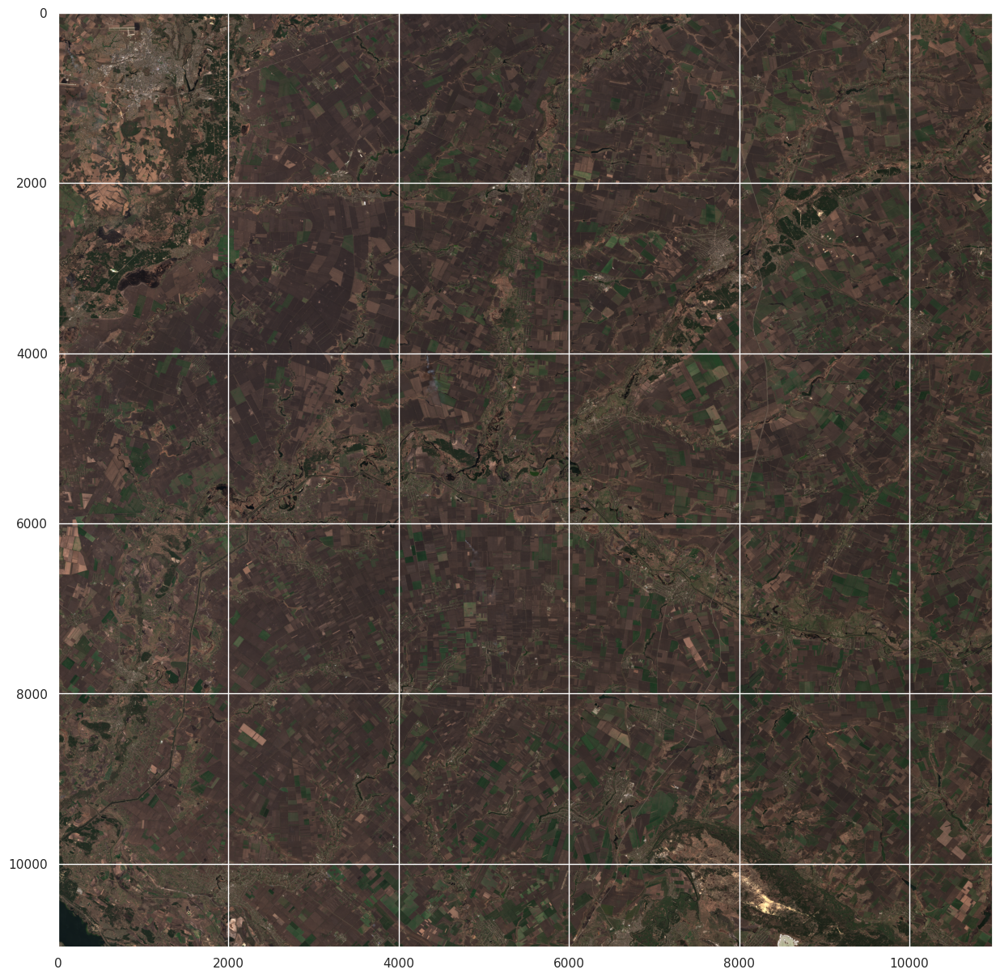

In [11]:
with rasterio.open(jp2_path, 'r', driver='JP2OpenJPEG') as src:
    raster_img = src.read()
    raster_meta = src.meta

plt.figure(figsize=(15,15))
# Transform (C,H,W) -> (H,W,C)
img = reshape_as_image(raster_img)
plt.imshow(img)

We can see that the data we received is just one giant picture. This data will clearly not be enough to train the own model, so we will use pretrained one, which will be faster also.

In [12]:
labels = gpd.read_file("masks/Masks_T36UXV_20190427.shp").drop(['id', 'Data', 'Comments'], axis=1)
labels

,Code,Descriptio,Image,geometry
0,2.0,branch of tree,T36UXV_20190427T083601,"POLYGON ((35.62916 49.60293, 35.63015 49.60163..."
1,1.0,color+ feathers,T36UXV_20190427T083601,"POLYGON ((35.65070 49.60254, 35.65248 49.60301..."
2,2.0,brahch of tree,T36UXV_20190427T083601,"POLYGON ((35.63023 49.60826, 35.62960 49.60920..."
3,1.0,color+ feathers,T36UXV_20190427T083601,"POLYGON ((35.62033 49.60905, 35.62064 49.60968..."
4,1.0,color+ feathers,T36UXV_20190427T083601,"POLYGON ((35.60455 49.61078, 35.60597 49.61228..."
...,...,...,...,...
931,1.0,color+ structure,T36UXV_20190427T083601,"POLYGON ((35.60033 49.04547, 35.60011 49.04496..."
932,1.0,color+ structure,T36UXV_20190427T083601,"POLYGON ((35.59042 49.04165, 35.59127 49.04155..."
933,1.0,color+ structure,T36UXV_20190427T083601,"POLYGON ((35.60754 49.05593, 35.60796 49.05600..."
934,1.0,color+ structure,T36UXV_20190427T083601,"POLYGON ((35.52378 48.76951, 35.52332 48.76918..."


Behind the scenes, I also checked the contents of other files from the mask folder (but not all of them could be opened). So it looks like they all contain the same data set so far. So, as labels, we have the coordinates of the polygons that mark the soil that has undergone erosion on our giant picture. I dropped id, Data, Comment, because there are completely missing data.

In [133]:
display(labels.Code.value_counts())
print('#' * 25)
labels.Descriptio.value_counts()

1.0    239
2.0     74
5.0     13
3.0     10
9.0      3
4.0      1
Name: Code, dtype: int64

#########################


color+ structure            212
branch of tree               73
color+ feathers              24
color (opodz)                11
small branch                  4
???                           3
color + feathers              2
branch + color+ feathers      2
brahch of tree                1
color+ feathers + branch      1
color (map NGO)               1
small tree                    1
Name: Descriptio, dtype: int64

<Axes: >

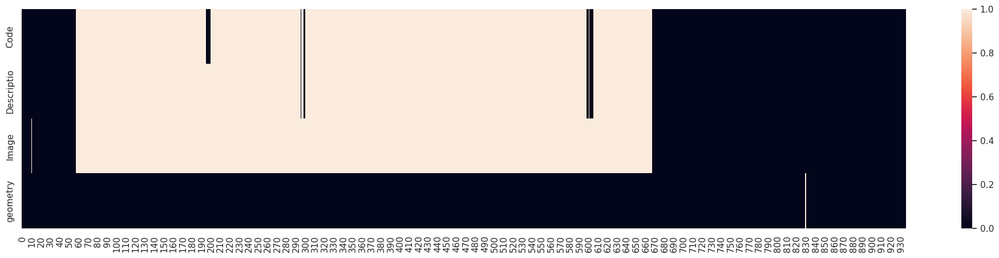

In [134]:
plt.figure(figsize=(25,5))
sns.heatmap(labels.isna().T)

Also, in addition to polygons, our data contains information about the Code of this polygon, which is still difficult to interpret, but it may help in the future to understand model errors. We also have a description field, which most likely describes the terrain of the landfill. Much of this data is lost. One missing value in polygon (geometry).

In [135]:
labels.geometry[0].exterior.coords.xy

(array('d', [35.62916346617293, 35.63014960535702, 35.631175190108465, 35.631214635675825, 35.630031268654925, 35.62888734720139, 35.62813788142149, 35.62774342574785, 35.62813788142149, 35.62916346617293]),
 array('d', [49.602931546762534, 49.60162984303954, 49.60080148612491, 49.59981534694083, 49.6001703570471, 49.60111705066382, 49.60214263541526, 49.60289210119517, 49.60312877459935, 49.602931546762534]))

In [13]:
# let's remove row without geometry
labels = labels[labels.geometry.notnull()]

# assigning crs
# sources: https://www.youtube.com/watch?v=xJyJlKbZFlc, http://projfinder.com/
#labels.crs = {'init' :'epsg:4630'}
labels.crs = {'init' :'epsg:4326'}

#transforming polygons to the raster crs
labels = labels.to_crs({'init' : raster_meta['crs']['init']})
labels

,Code,Descriptio,Image,geometry
0,2.0,branch of tree,T36UXV_20190427T083601,"POLYGON ((689961.152 5497804.667, 690037.456 5..."
1,1.0,color+ feathers,T36UXV_20190427T083601,"POLYGON ((691518.623 5497815.456, 691645.003 5..."
2,2.0,brahch of tree,T36UXV_20190427T083601,"POLYGON ((690017.383 5498399.293, 689968.112 5..."
3,1.0,color+ feathers,T36UXV_20190427T083601,"POLYGON ((689299.133 5498462.011, 689319.252 5..."
4,1.0,color+ feathers,T36UXV_20190427T083601,"POLYGON ((688152.716 5498615.331, 688249.512 5..."
...,...,...,...,...
931,1.0,color+ structure,T36UXV_20190427T083601,"POLYGON ((690012.338 5435767.601, 689998.527 5..."
932,1.0,color+ structure,T36UXV_20190427T083601,"POLYGON ((689303.051 5435318.547, 689365.361 5..."
933,1.0,color+ structure,T36UXV_20190427T083601,"POLYGON ((690499.318 5436948.995, 690529.292 5..."
934,1.0,color+ structure,T36UXV_20190427T083601,"POLYGON ((685438.102 5404906.207, 685405.307 5..."


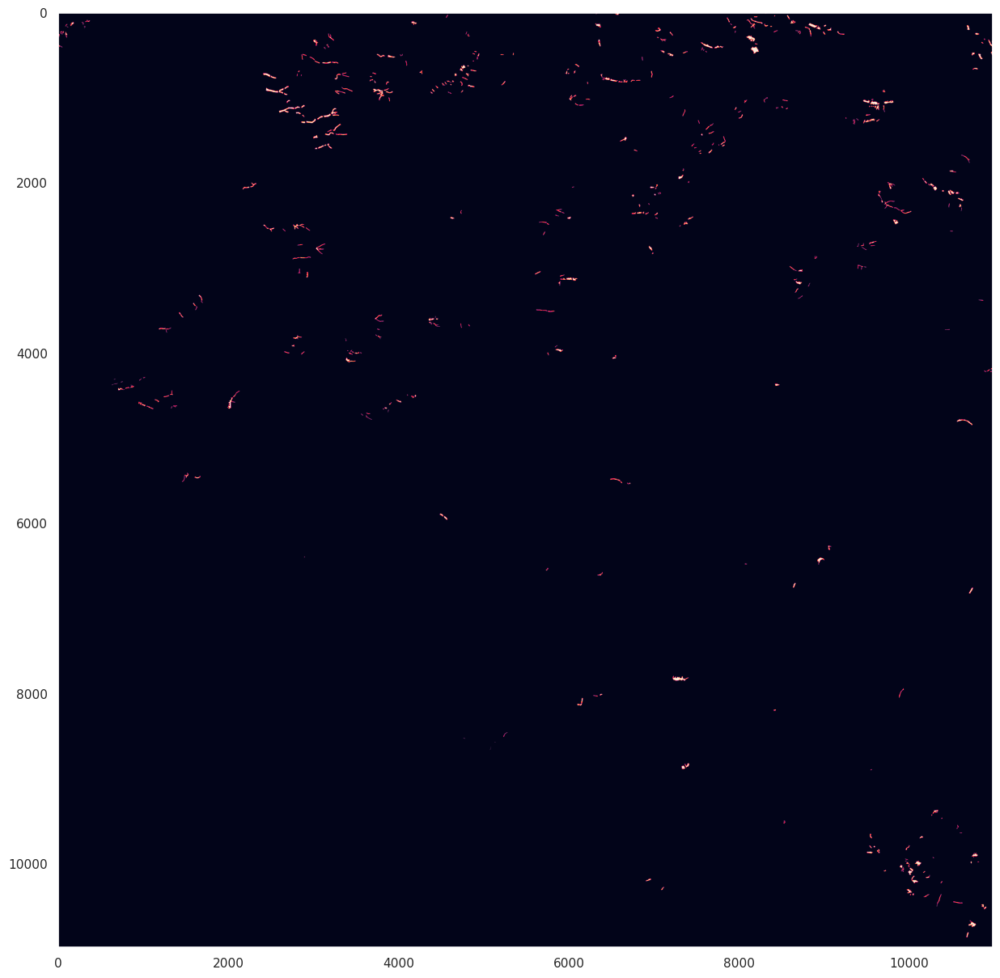

In [14]:
def create_mask(src, labels):
    def poly_from_utm(polygon, transform):
        poly_pts = []
        
        # make a polygon from multipolygon
        poly = cascaded_union(polygon)
        for i in np.array(poly.exterior.coords):
            
            # transfrom polygon to image crs, using raster meta
            poly_pts.append(~transform * tuple(i))
            
        # make a shapely Polygon object
        new_poly = Polygon(poly_pts)
        return new_poly


    # creating binary mask for field/not_filed segmentation.
    poly_shp = []
    im_size = (src.meta['height'], src.meta['width'])
    for num, row in labels.iterrows():
        if row['geometry'].geom_type == 'Polygon':
            poly = poly_from_utm(row['geometry'], src.meta['transform'])
            poly_shp.append(poly)

    # rasterize works with polygons that are in image coordinate system
    mask = rasterize(shapes=poly_shp,
                    out_shape=im_size)
    
    return mask


mask = create_mask(src, labels)
# plotting the mask
plt.figure(figsize=(15,15))
plt.imshow(mask)
plt.grid(False)

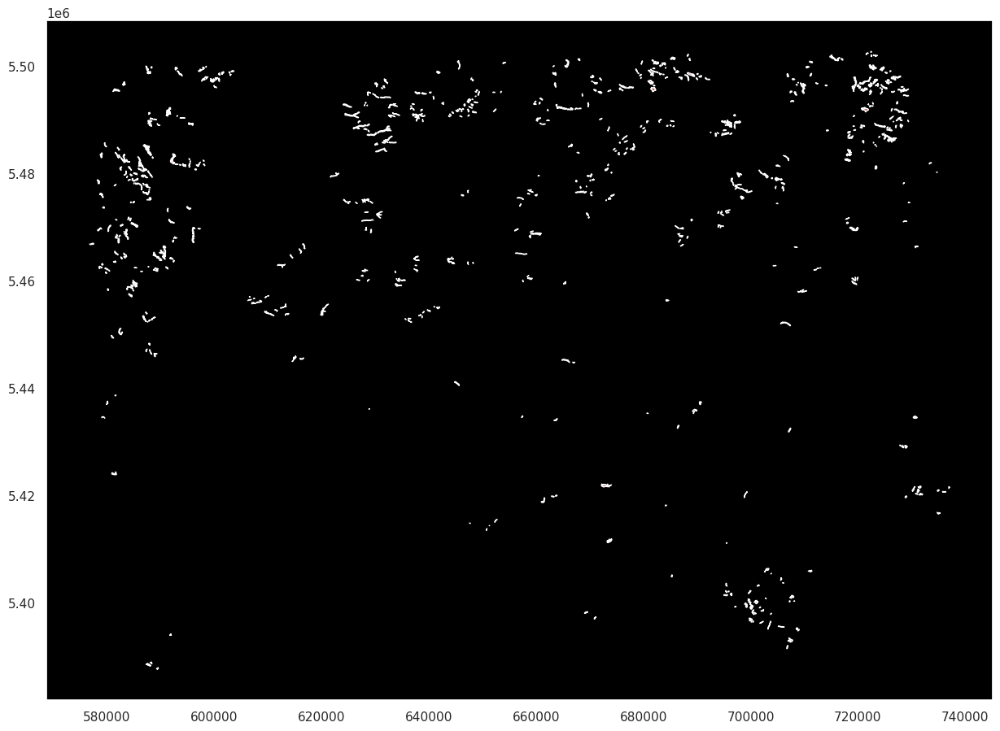

In [141]:
plt.rcParams['axes.facecolor'] = 'black'
labels['geometry'].plot(color='r', figsize=(15, 15))
plt.grid(False)

Wonderful! We managed to reproduce and glue all our masks together, so now we have identical images and a mask to segment it. Although, unfortunately, we see that we do not have the entire image, that is, we also have polygons outside the image available to us. Since we cannot get more images at the moment, we will have to get rid of them. Let's start constructing datasets for our future model, since there is not a lot of data, we can save them on the local machine. The size of our giant image is 10980x10980, which will be perfectly divided into 45 pieces of 244 in each direction. With this division, we will have 2025 objects for training, from the bottom 15 percent will be allocated to the validation dataset and 15 to the test dataset.

In [142]:
def crop_and_save(img, mask, crop_size=244, save_path=Config.data_path, with_info_only=True, random_state=Config.seed):
    np.random.seed(random_state)
    
    shutil.rmtree(save_path, ignore_errors=True)
    [os.makedirs(os.path.join(save_path, folder, subfolder)) for \
        folder in ['train', 'valid', 'test'] for subfolder in ['images', 'masks']]
    
    for j in np.arange(img.shape[1] / crop_size, dtype=np.int64):
        for i in np.arange(img.shape[0] / crop_size, dtype=np.int64):
            crop_img = img[i*crop_size: i*crop_size + crop_size, j*crop_size: j*crop_size + crop_size]
            crop_mask = mask[i*crop_size: i*crop_size + crop_size, j*crop_size: j*crop_size + crop_size]
            
            # save only crops with mask content if with_info_only
            if crop_mask.sum() / crop_size**2 <= 0.02 and with_info_only:
                continue
            
            dataset = 'train'
            # 70 % to appear in train
            if np.random.choice([0, 1], p=[0.7, 0.3]):
                dataset = 'valid'
                # 15% to appear in test or valid
                if np.random.choice([0, 1]):
                    dataset = 'test'
            
            img_path = os.path.join(save_path, dataset, 'images', f'crop_{i}_{j}.jpg')
            mask_path = os.path.join(save_path, dataset, 'masks', f'crop_{i}_{j}.jpg')
            cv.imwrite(img_path, crop_img)
            # mask has only 0 and 1 values
            crop_mask = (crop_mask != 0).astype(np.float64)
            cv.imwrite(mask_path, crop_mask)

    
crop_and_save(img, mask)

print(f'Train size: {len(os.listdir("data/train/images"))}')
print(f'Valid size: {len(os.listdir("data/valid/images"))}')
print(f'Test size: {len(os.listdir("data/test/images"))}')

Train size: 198
Valid size: 37
Test size: 39


We now have a perfectly distributed dataset ready to feed into the model, but first let's take a closer look at our data and visualize a few patches and their corresponding masks. You can investigate different images by changing <b>random_state</b>.

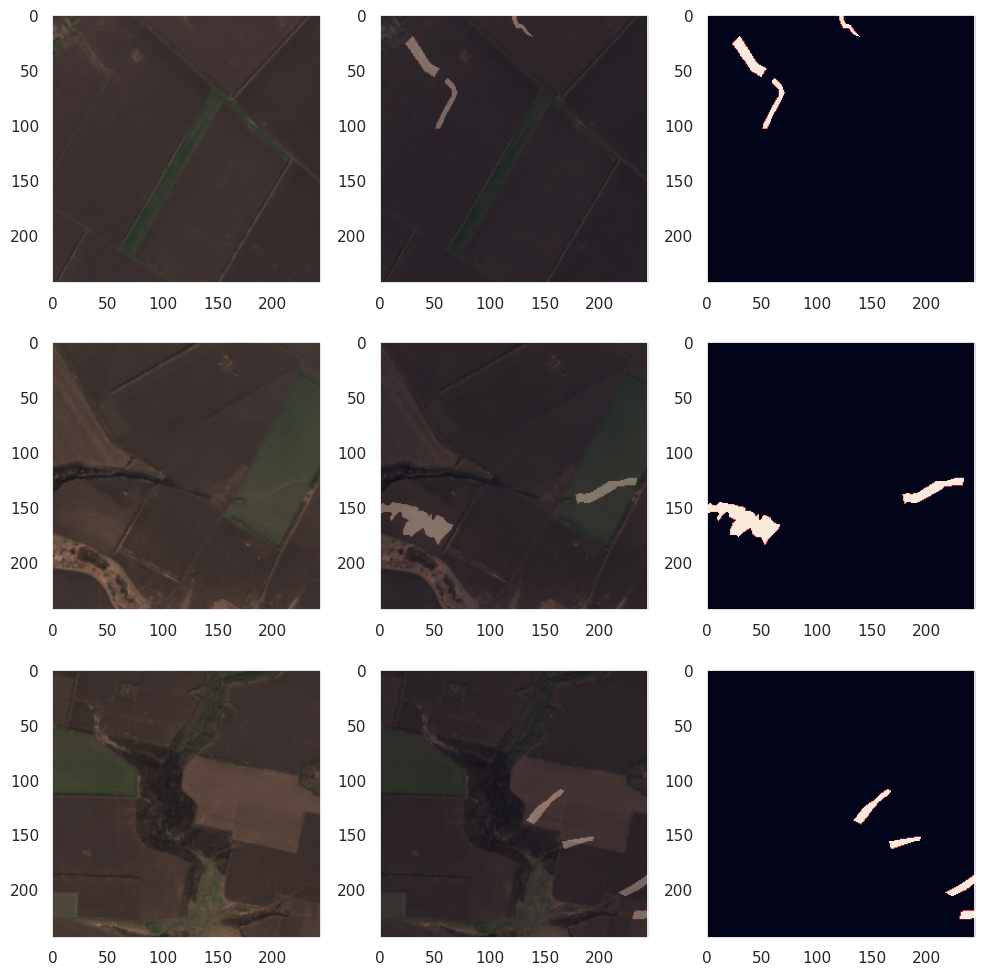

In [143]:
def plot_grid(img, mask, nrows=3, crop_size=244, figsize=(10,10), random_state=13):
    fig, ax = plt.subplots(nrows, 3, figsize=figsize)
    np.random.seed(13)
    
    while nrows:
        x = np.random.randint(img.shape[0] - crop_size)
        y = np.random.randint(img.shape[1] - crop_size)
        crop_img = img[x: x + crop_size, y: y + crop_size]
        crop_mask = mask[x: x + crop_size, y: y + crop_size]
        
        if crop_mask.sum() == 0:
            continue
        nrows -= 1
        
        ax[nrows, 0].imshow(crop_img)
        ax[nrows, 1].imshow(crop_img)
        ax[nrows, 1].imshow(crop_mask*255, alpha=0.3)
        ax[nrows, 2].imshow(crop_mask*255)
        ax[nrows, 0].grid(False)
        ax[nrows, 1].grid(False)
        ax[nrows, 2].grid(False)       
        
    plt.tight_layout()
    plt.show()


sns.set()    
plot_grid(img, mask)

Now we have the ability to quickly look at examples of objects that our model will study. Let's return to additional data in these labels. This time we will try to build a mask for individual Codes or Decriptions and try to understand if they have any significant context.

In [144]:
labels_code1 = labels[labels.Code == 1.0]
labels_code2 = labels[labels.Code == 2.0]
labels_des_color = labels[labels.Descriptio == 'color+ structure']
labels_des_branch = labels[labels.Descriptio == 'branch of tree']

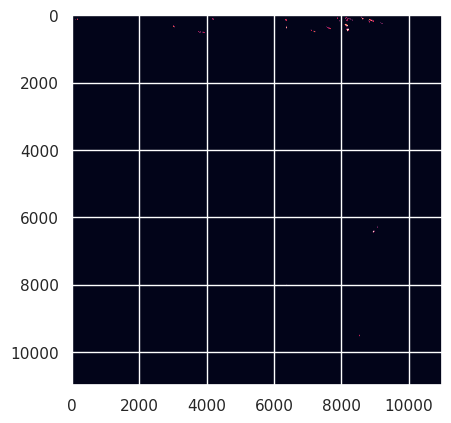

In [145]:
plt.imshow(create_mask(src, labels_code1))

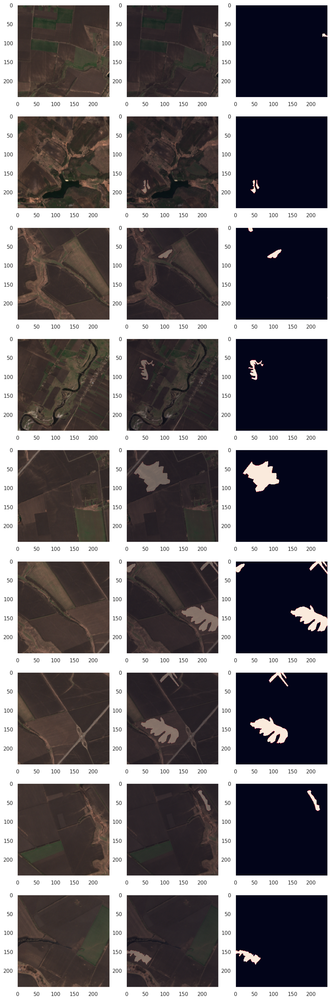

In [146]:
plot_grid(img, create_mask(src, labels_code1), nrows=9, figsize=(10, 30))

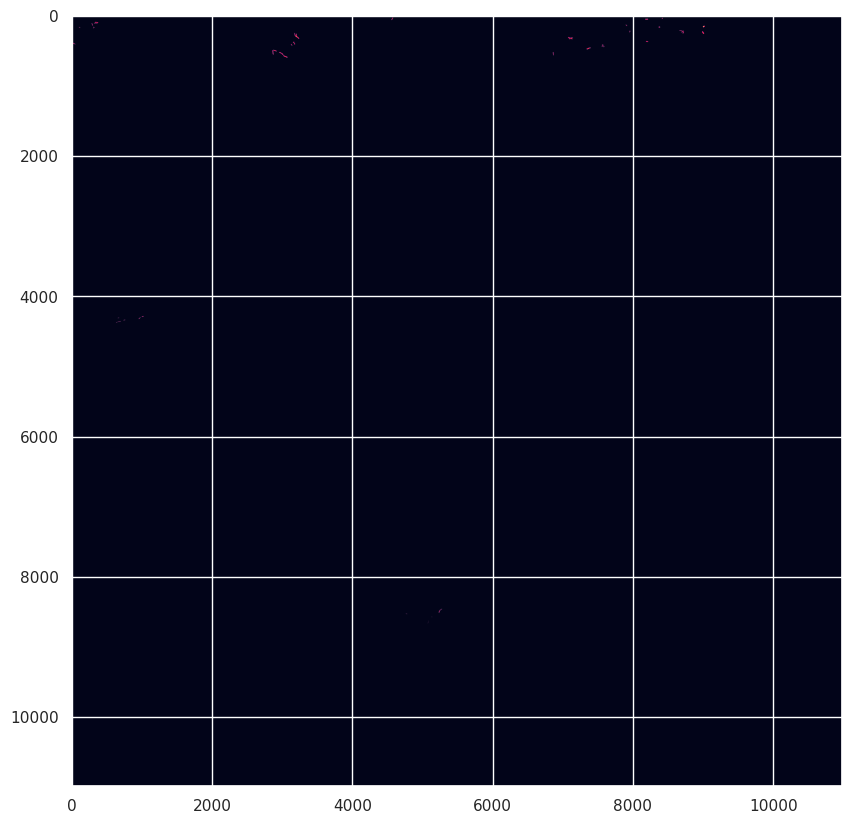

In [147]:
plt.figure(figsize=(10,10))
plt.imshow(create_mask(src, labels_code2))

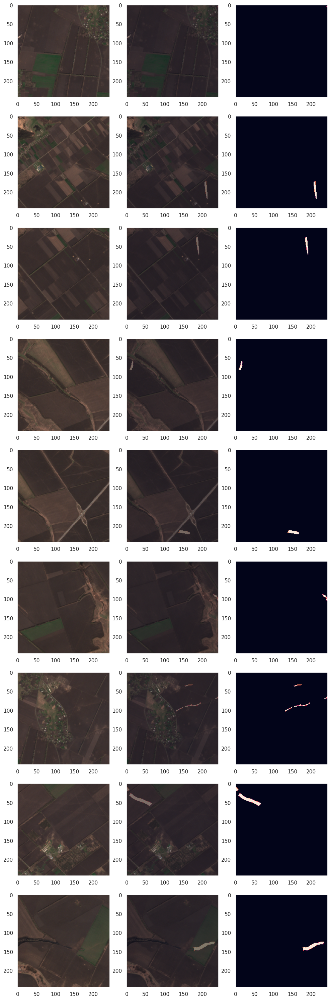

In [148]:
plot_grid(img, create_mask(src, labels_code2), nrows=9, figsize=(10, 30))

Among the Code, I only examine 1.0 and 2.0, because they occur most frequently. The same among Destriptio - color + structure and branch of tree. Behind the scene, I ran several dozen examples of the Code 1.0 and 2.0 class, but I didn't notice any significant differences, except that, in my opinion, the objects in Code 1.0 are larger in shape and not as elongated.

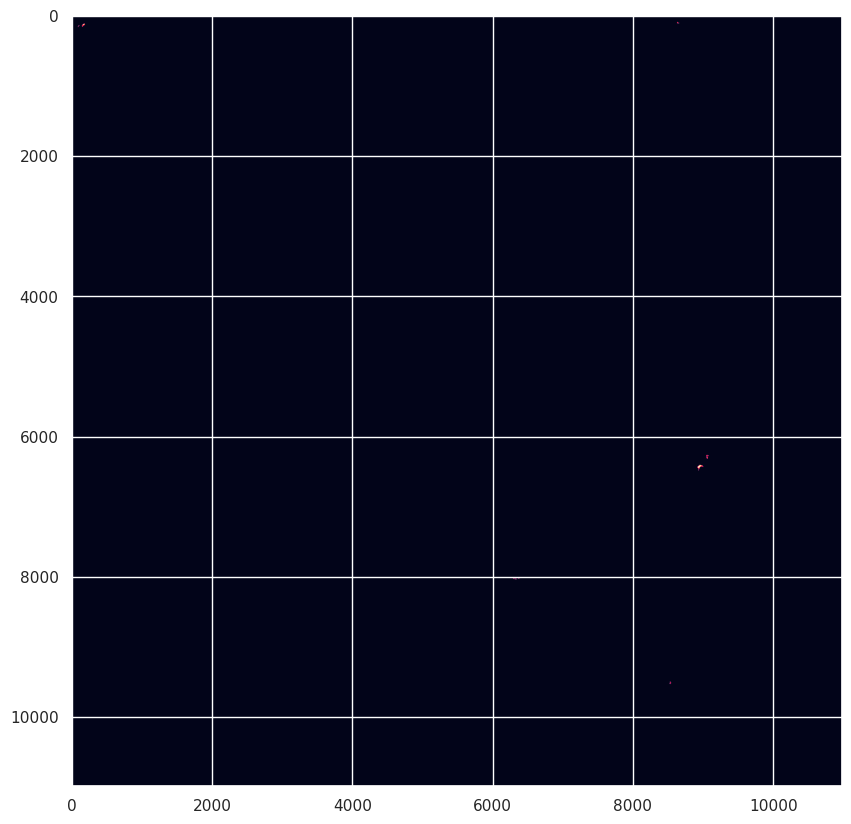

In [149]:
plt.figure(figsize=(10,10))
plt.imshow(create_mask(src, labels_des_color))

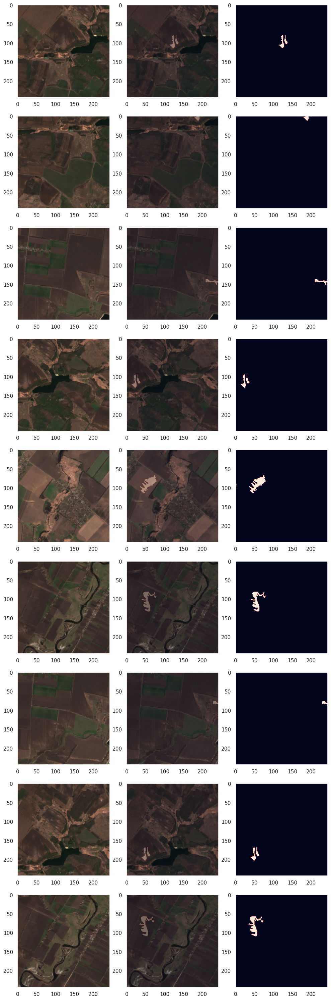

In [150]:
plot_grid(img, create_mask(src, labels_des_color), nrows=9, figsize=(10, 30))

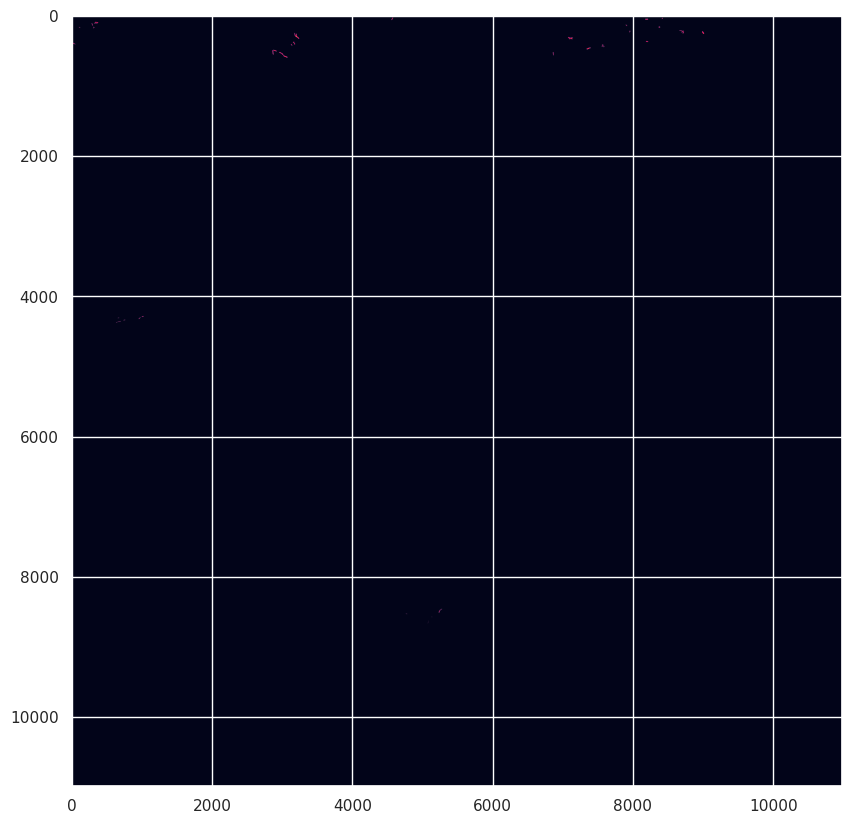

In [151]:
plt.figure(figsize=(10,10))
plt.imshow(create_mask(src, labels_des_branch))

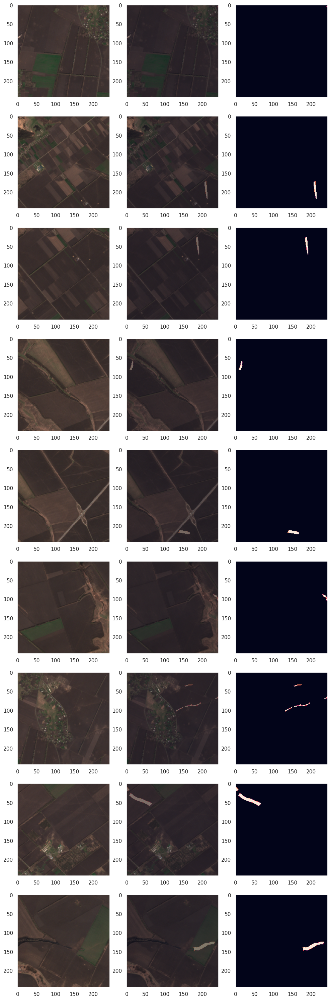

In [152]:
plot_grid(img, create_mask(src, labels_des_branch), nrows=9, figsize=(10, 30))

Unfortunately, I did not find any obvious patterns for myself. We can start modeling
# Modeling
## Pure Pytorch & Python approach

We will create appropriate datasets, we will not apply augmentation now, but we will leave room here for experiments in the future.

In [2]:
set_seed(Config.seed)

datasets = {name: SoilErosionDataset(name, get_transforms(name)) for name in ['train', 'valid', 'test']}
dataloaders = {name: DataLoader(datasets[name], batch_size=Config.batch_size, 
                                shuffle=get_shuffle(name), num_workers=Config.num_workers) 
               for name in ['train', 'valid', 'test']}

At the initial stage, we will download the standard pre-trained Unet model and configure the entire training flow.

In [3]:
model = smp.Unet(encoder_name='efficientnet-b7', encoder_depth=3, encoder_weights='imagenet', decoder_channels=[256, 128, 64], decoder_use_batchnorm=True)
model

Unet(
  (encoder): EfficientNetEncoder(
    (_conv_stem): Conv2dStaticSamePadding(
      3, 64, kernel_size=(3, 3), stride=(2, 2), bias=False
      (static_padding): ZeroPad2d((0, 1, 0, 1))
    )
    (_bn0): BatchNorm2d(64, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
    (_blocks): ModuleList(
      (0): MBConvBlock(
        (_depthwise_conv): Conv2dStaticSamePadding(
          64, 64, kernel_size=(3, 3), stride=[1, 1], groups=64, bias=False
          (static_padding): ZeroPad2d((1, 1, 1, 1))
        )
        (_bn1): BatchNorm2d(64, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
        (_se_reduce): Conv2dStaticSamePadding(
          64, 16, kernel_size=(1, 1), stride=(1, 1)
          (static_padding): Identity()
        )
        (_se_expand): Conv2dStaticSamePadding(
          16, 64, kernel_size=(1, 1), stride=(1, 1)
          (static_padding): Identity()
        )
        (_project_conv): Conv2dStaticSamePaddi

Epoch 1/25: TrainLoss 0.029 ValidLoss: 0.093 ValidIoU: 0.006
Epoch 2/25: TrainLoss 0.024 ValidLoss: 0.099 ValidIoU: 0.008
Epoch 3/25: TrainLoss 0.022 ValidLoss: 0.105 ValidIoU: 0.010
Epoch 4/25: TrainLoss 0.020 ValidLoss: 0.117 ValidIoU: 0.013
Epoch 5/25: TrainLoss 0.020 ValidLoss: 0.118 ValidIoU: 0.012
Epoch 6/25: TrainLoss 0.018 ValidLoss: 0.120 ValidIoU: 0.011
Epoch 7/25: TrainLoss 0.017 ValidLoss: 0.120 ValidIoU: 0.008
Epoch 8/25: TrainLoss 0.017 ValidLoss: 0.122 ValidIoU: 0.010
Epoch 9/25: TrainLoss 0.016 ValidLoss: 0.125 ValidIoU: 0.009
Epoch 10/25: TrainLoss 0.015 ValidLoss: 0.125 ValidIoU: 0.010
Epoch 11/25: TrainLoss 0.015 ValidLoss: 0.125 ValidIoU: 0.007
Epoch 12/25: TrainLoss 0.014 ValidLoss: 0.133 ValidIoU: 0.008
Epoch 13/25: TrainLoss 0.014 ValidLoss: 0.140 ValidIoU: 0.003
Epoch 14/25: TrainLoss 0.013 ValidLoss: 0.136 ValidIoU: 0.006
Epoch 15/25: TrainLoss 0.013 ValidLoss: 0.140 ValidIoU: 0.006
Epoch 16/25: TrainLoss 0.012 ValidLoss: 0.140 ValidIoU: 0.006
Epoch 17/25: Trai

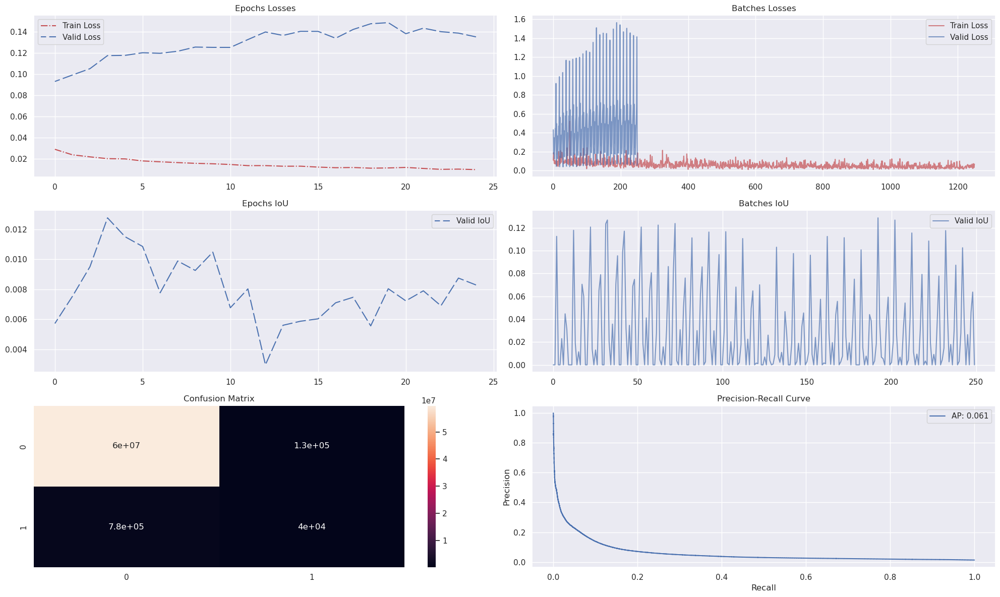

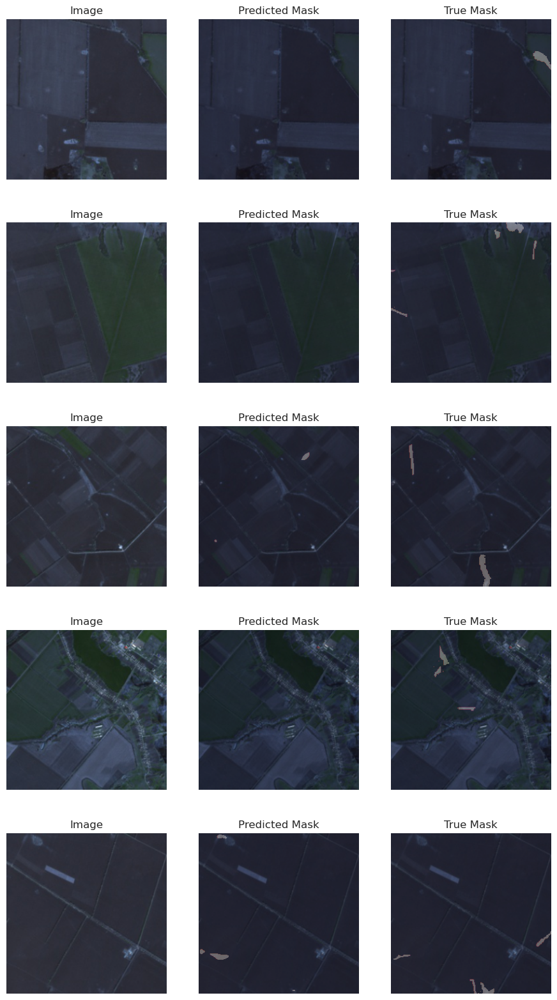

In [13]:
optimizer = torch.optim.Adam(model.parameters(), lr=Config.learning_rate)
criterion = torch.nn.BCEWithLogitsLoss()
lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min')
model_name = 'unet_efficientnet-b7'

callbackers = train(model, optimizer, criterion, dataloaders['train'], dataloaders['valid'], model_name=model_name)
best_model = deepcopy(model)
best_model.load_state_dict(torch.load(f'{Config.model_path}/{model_name}.pt'))

visualize_callbackers(callbackers)
plot_results(best_model, datasets['valid'])
del best_model

Timeline (all my attempts before getting the results of the finall model above):
- tried a normal Unet with a mobilenet-v2 backbone, the loss drops, but the model does not produce a result (determines everything as background)
- added a learning speed schedule (it didn't give results yet, so I removed it, I'll come back later)
- tried the efficientnet-b7 ridge, the model started to notice objects not only in the background but very very little
- added data augmentation (it didn't work, most likely a problem with the model)
- I looked at the architecture and realized that I am feeding models to the 256x256 image input with 5 stages in the encoder, which in the bottleneck gives an 8x8 matrix, which may not be enough, reduced the number of encoder stages to 3

My attempts did not yield results, but it is clear that the model is now learning something and the IoU is no longer zero, but very, very small (at best 0.013). I got the idea that the model receives little input for training, meaning the masks are very sparse. I think it's worth redesigning the way we extract the image from the mask. This time we will crop each polygon and make some indents if necessary to reach an image size close to 128. This way we will have smaller images than before, with valuable information in the center of each one. I'll also have to play around with the padding size for the cropped images of different sizes

In [8]:
def locate_and_save(img, mask, adjust=True, save_path=Config.data_path, random_state=Config.seed):
    def poly_from_utm(polygon, transform):
        poly_pts = []
        
        # make a polygon from multipolygon
        poly = cascaded_union(polygon)
        for i in np.array(poly.exterior.coords):
            
            # transfrom polygon to image crs, using raster meta
            poly_pts.append(~transform * tuple(i))
            
        # make a shapely Polygon object
        new_poly = Polygon(poly_pts)
        return new_poly

    def locate_mask(shape):
        c = shape.sum(axis=0)
        r = shape.sum(axis=1)
        min_x = np.argmax(r > 0)
        max_x = r.shape[0] - np.argmax(r[::-1] > 0)
        min_y = np.argmax(c > 0)
        max_y = c.shape[0] - np.argmax(c[::-1] > 0)
        
        return min_x, max_x, min_y, max_y
    
    def update_box(upd, xmin, xmax, ymin, ymax):
        xmin = np.max((0, xmin - upd))
        xmax = np.min((img.shape[0], xmax + upd))
        ymin = np.max((0, ymin - upd))
        ymax = np.min((img.shape[1], ymax + upd))
        
        return xmin, xmax, ymin, ymax
    
    np.random.seed(random_state)
    
    shutil.rmtree(save_path, ignore_errors=True)
    [os.makedirs(os.path.join(save_path, folder, subfolder)) for \
        folder in ['train', 'valid', 'test'] for subfolder in ['images', 'masks']]
    
    # creating binary mask for field/not_filed segmentation.
    im_size = (src.meta['height'], src.meta['width'])
    for i, (num, row) in enumerate(labels.iterrows()):
        if row['geometry'].geom_type == 'Polygon':
            poly = poly_from_utm(row['geometry'], src.meta['transform'])
        # rasterize works with polygons that are in image coordinate system
        new_mask = rasterize(shapes=[poly], out_shape=im_size)
        xmin, xmax, ymin, ymax = locate_mask(new_mask)
        
        if adjust:
            if xmax - xmin > 110 or ymax - ymin > 110:
                xmin, xmax, ymin, ymax = update_box(5, xmin, xmax, ymin, ymax)
            elif xmax - xmin > 80 or ymax - ymin > 80: 
                xmin, xmax, ymin, ymax = update_box(15, xmin, xmax, ymin, ymax)
            elif xmax - xmin > 50 or ymax - ymin > 50: 
                xmin, xmax, ymin, ymax = update_box(30, xmin, xmax, ymin, ymax)
            elif xmax - xmin > 20 or ymax - ymin > 20: 
                xmin, xmax, ymin, ymax = update_box(40, xmin, xmax, ymin, ymax)
            elif xmax - xmin > 10 and ymax - ymin > 10: 
                xmin, xmax, ymin, ymax = update_box(50, xmin, xmax, ymin, ymax)
            else:
                continue
            if xmin > 50 and ymin > 50 and xmax < 10900 and ymax < 10900:
                x_shift = (-1) ** np.random.randint(1, 3) * np.random.randint(0, 25)
                y_shift = (-1) ** np.random.randint(1, 3) * np.random.randint(0, 25)
                xmin += x_shift
                xmax += x_shift
                ymin += y_shift
                ymax += y_shift
        
        crop_img = img[xmin:xmax, ymin:ymax]
        crop_mask = mask[xmin:xmax, ymin:ymax]
        
        # skip polygons that outside of our image
        if crop_mask.shape == mask.shape:
            continue
        
        #Since we selectively cut polygons, we can't be sure that some piece of train data won't get \
            # into the test ones, so we divide our mask into 3 rectangles, corresponding to the 3 \
                # datasets, to avoid data leakage
        dataset = None
        if ymin > 8_000:
            if xmin > 2500:
                dataset = 'test'
            elif xmax < 2500:
                dataset = 'valid'
        elif ymax < 8_000:
            dataset = 'train'
                
        if dataset:
            img_path = os.path.join(save_path, dataset, 'images', f'crop_{i}.jpg')
            mask_path = os.path.join(save_path, dataset, 'masks', f'crop_{i}.jpg')
            
            cv.imwrite(img_path, crop_img)
            cv.imwrite(mask_path, crop_mask)
        
        
locate_and_save(img, mask, adjust=False)

print(f'Train size: {len(os.listdir(f"{Config.data_path}/train/images"))}')
print(f'Valid size: {len(os.listdir(f"{Config.data_path}/valid/images"))}')
print(f'Test size: {len(os.listdir(f"{Config.data_path}/test/images"))}')

Train size: 325
Valid size: 90
Test size: 83


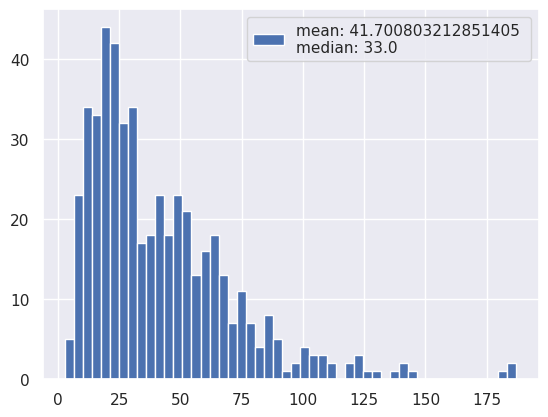

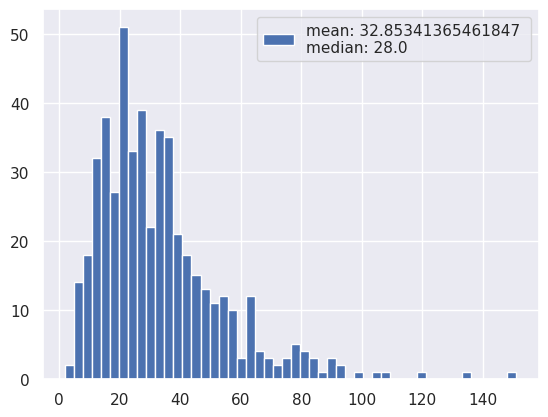

In [9]:
images = []
for dir in ['train', 'valid', 'test']:
    for fl in os.listdir(f'{Config.data_path}/{dir}/images/'):
        path = os.path.join(f'{Config.data_path}/{dir}/images/', fl)
        im = cv.imread(path)
        images.append(im)
    
x = []
y = []
for im in images:
    x.append(im.shape[1])
    y.append(im.shape[0])
    
plt.hist(x, bins=50, label=f'mean: {np.mean(x)} \nmedian: {np.median(x)}')
plt.legend()
plt.show()
plt.hist(y, bins=50, label=f'mean: {np.mean(y)} \nmedian: {np.median(y)}')
plt.legend()
plt.show()

We have a fairly wide scope of distribution, most fragments have a size of 30x40, which is quite small. Let's try to expand them a little and remove those that are too small and will not bring any benefit.

Train size: 308
Valid size: 83
Test size: 78


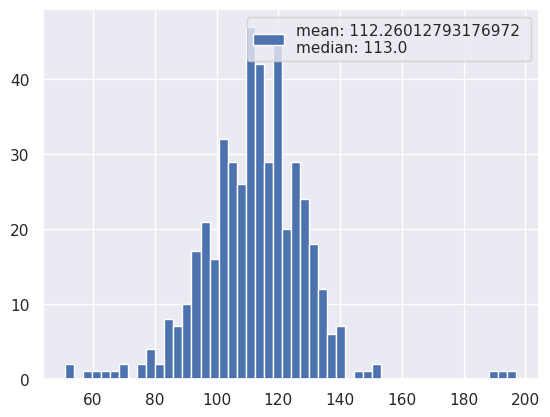

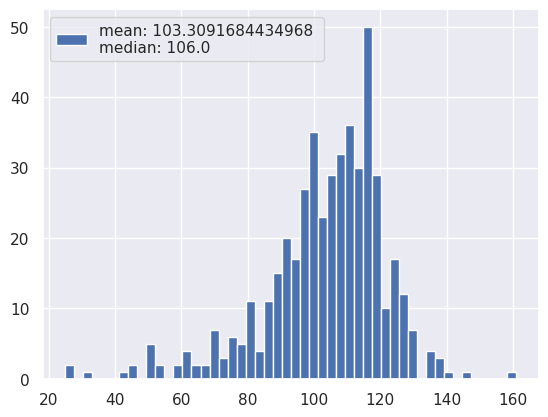

In [10]:
locate_and_save(img, mask, adjust=True)

print(f'Train size: {len(os.listdir(f"{Config.data_path}/train/images"))}')
print(f'Valid size: {len(os.listdir(f"{Config.data_path}/valid/images"))}')
print(f'Test size: {len(os.listdir(f"{Config.data_path}/test/images"))}')

images = []
for dir in ['train', 'valid', 'test']:
    for fl in os.listdir(f'{Config.data_path}/{dir}/images/'):
        path = os.path.join(f'{Config.data_path}/{dir}/images/', fl)
        im = cv.imread(path)
        images.append(im)
    
x = []
y = []
for im in images:
    x.append(im.shape[1])
    y.append(im.shape[0])
    
plt.hist(x, bins=50, label=f'mean: {np.mean(x)} \nmedian: {np.median(x)}')
plt.legend()
plt.show()
plt.hist(y, bins=50, label=f'mean: {np.mean(y)} \nmedian: {np.median(y)}')
plt.legend()
plt.show()

Great, now the size of the image is quite satisfactory for us, let's try to visualize some examples and make sure of it.

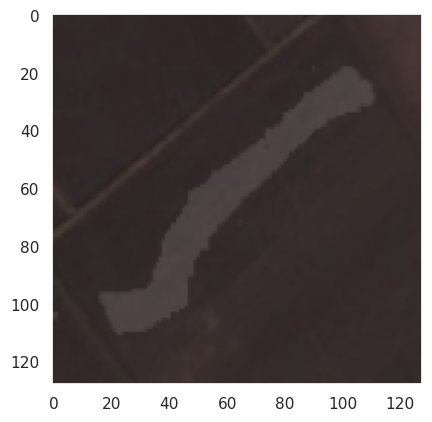

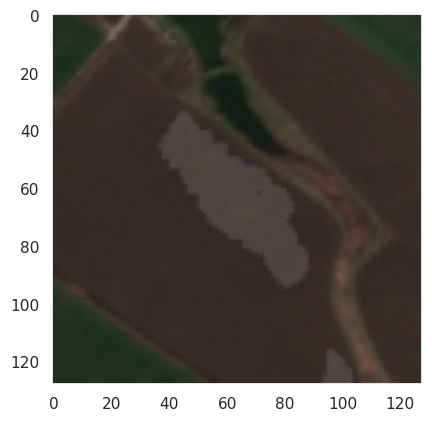

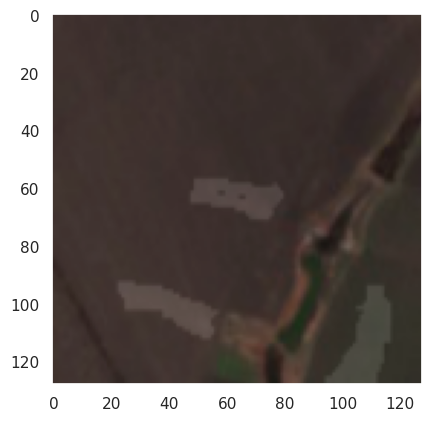

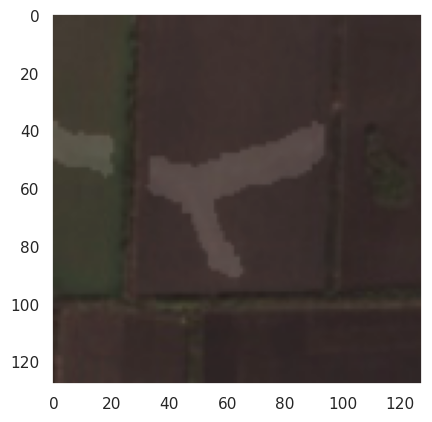

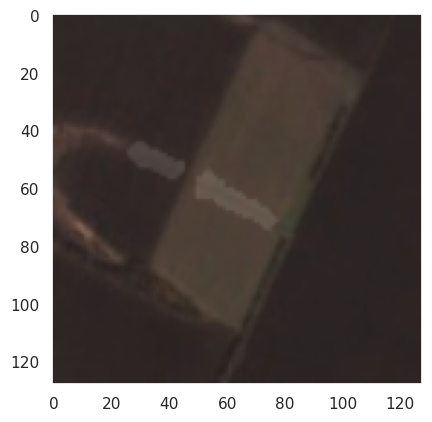

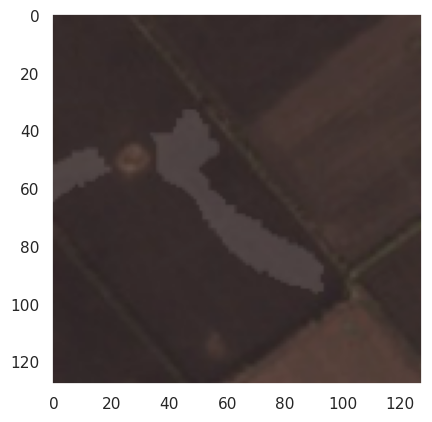

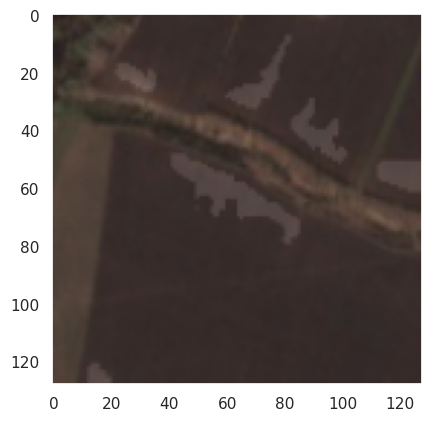

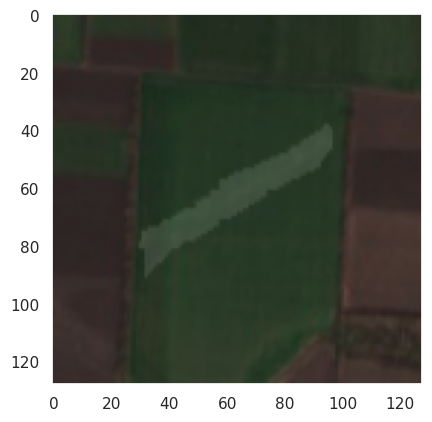

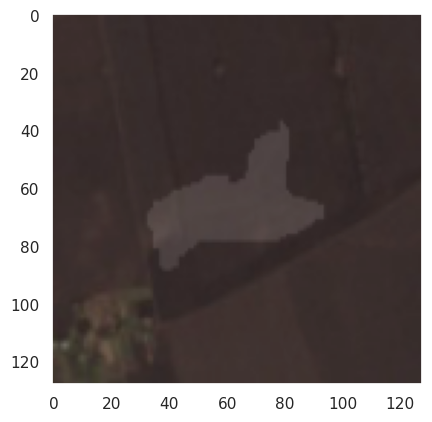

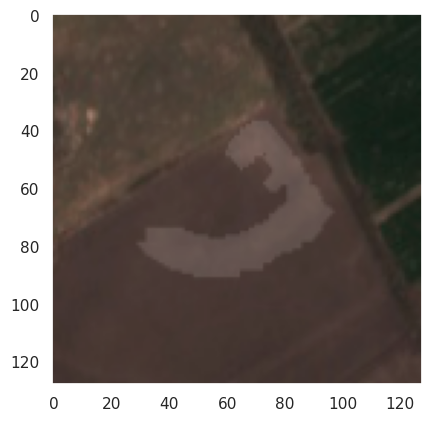

In [11]:
fls = os.listdir(os.path.join(Config.data_path, 'train/images'))
for fl in np.random.permutation(fls)[:10]:
    img_path = os.path.join(Config.data_path, 'train/images', fl)
    mask_path = os.path.join(Config.data_path, 'train/masks', fl)
    im = cv.imread(img_path)
    msk = cv.imread(mask_path)*255
    im = cv.resize(im, (128, 128))
    msk = cv.resize(msk, (128, 128))
    plt.imshow(im)
    plt.imshow(msk, alpha=0.1)
    plt.grid(False)
    plt.show()

We managed to more or less equalize the size of the images in the dataset, they look more informative now, let's try to train the model on this new data.

In [12]:

model = smp.Unet(encoder_name='efficientnet-b7', encoder_depth=3, encoder_weights='imagenet', decoder_channels=[256, 128, 64], decoder_use_batchnorm=True)

Epoch 1/30: TrainLoss 1.023 ValidLoss: 0.836 ValidIoU: 0.007
Epoch 2/30: TrainLoss 0.785 ValidLoss: 0.782 ValidIoU: 0.008
Epoch 3/30: TrainLoss 0.599 ValidLoss: 0.639 ValidIoU: 0.009
Epoch 4/30: TrainLoss 0.471 ValidLoss: 0.528 ValidIoU: 0.009
Epoch 5/30: TrainLoss 0.390 ValidLoss: 0.441 ValidIoU: 0.008
Epoch 6/30: TrainLoss 0.349 ValidLoss: 0.404 ValidIoU: 0.010
Epoch 7/30: TrainLoss 0.321 ValidLoss: 0.366 ValidIoU: 0.011
Epoch 8/30: TrainLoss 0.295 ValidLoss: 0.342 ValidIoU: 0.012
Epoch 9/30: TrainLoss 0.282 ValidLoss: 0.324 ValidIoU: 0.014
Epoch 10/30: TrainLoss 0.266 ValidLoss: 0.307 ValidIoU: 0.015
Epoch 11/30: TrainLoss 0.259 ValidLoss: 0.297 ValidIoU: 0.015
Epoch 12/30: TrainLoss 0.248 ValidLoss: 0.287 ValidIoU: 0.016
Epoch 13/30: TrainLoss 0.243 ValidLoss: 0.274 ValidIoU: 0.016
Epoch 14/30: TrainLoss 0.233 ValidLoss: 0.271 ValidIoU: 0.016
Epoch 15/30: TrainLoss 0.230 ValidLoss: 0.265 ValidIoU: 0.015
Epoch 16/30: TrainLoss 0.227 ValidLoss: 0.262 ValidIoU: 0.016
Epoch 17/30: Trai

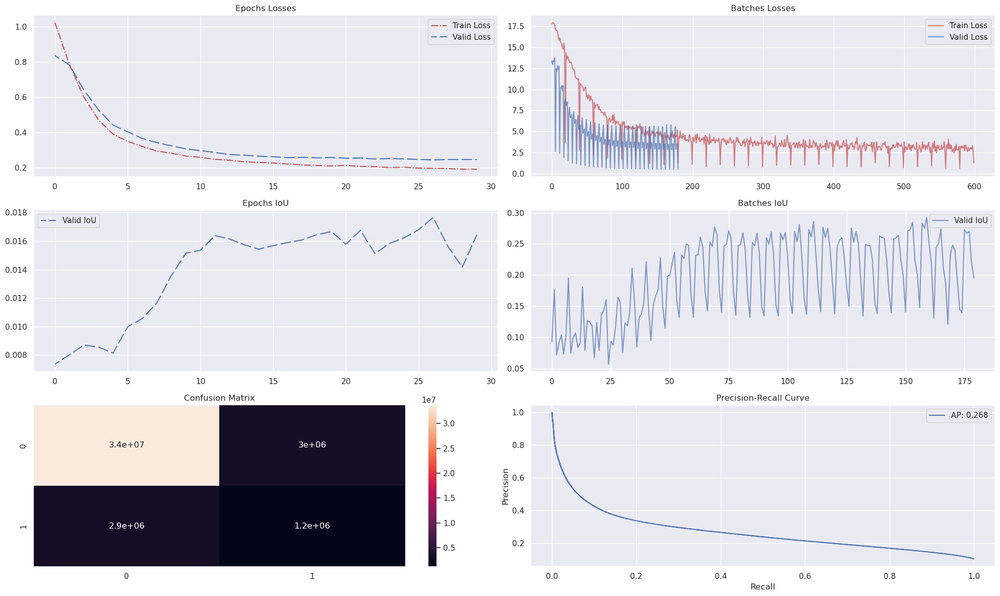

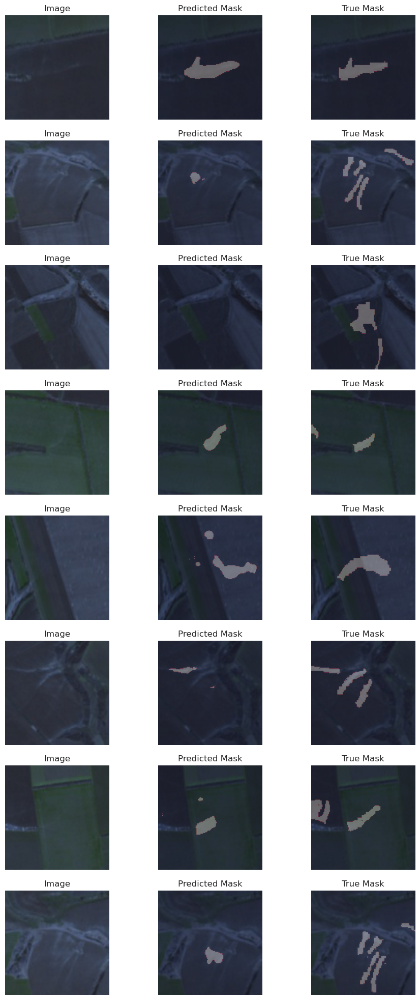

In [13]:
datasets = {name: SoilErosionDataset(name, get_transforms(name)) for name in ['train', 'valid', 'test']}
dataloaders = {name: DataLoader(datasets[name], batch_size=Config.batch_size, 
                                shuffle=get_shuffle(name), num_workers=Config.num_workers) 
               for name in ['train', 'valid', 'test']}

optimizer = torch.optim.Adam(model.parameters(), lr=Config.learning_rate)
criterion = torch.nn.BCEWithLogitsLoss()
lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min')
model_name = 'unet_efficientnet-b7'

callbackers = train(model, optimizer, criterion, dataloaders['train'], dataloaders['valid'], model_name=model_name)
best_model = deepcopy(model)
best_model.load_state_dict(torch.load(f'{Config.model_path}/{model_name}.pt'))

visualize_callbackers(callbackers)
plot_results(best_model, datasets['valid'])
del best_model

Well, this time the model gave better results, although still low. Despite this, it began to look for erosion in particular, and it can be seen from the examples that it quite often has an understanding of where erosion is found. This is very good progress! We also see that it suffers a lot from overfit, rather this is what we have to fight with in the future.

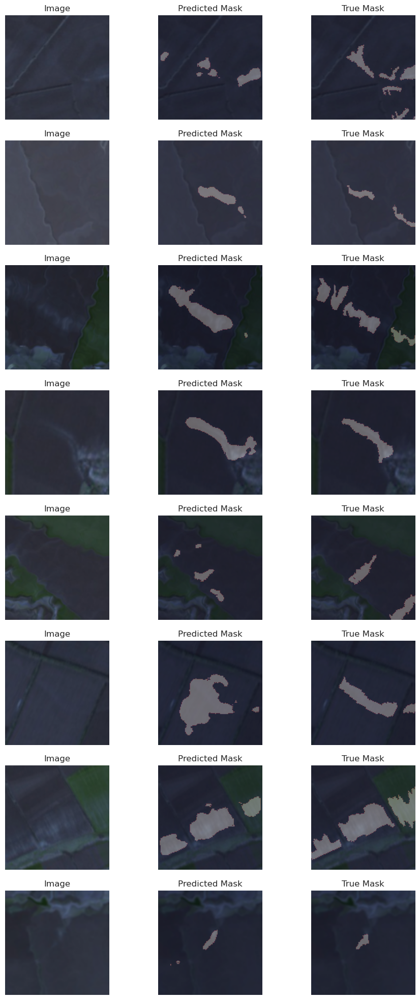

In [14]:
best_model = deepcopy(model)
best_model.load_state_dict(torch.load(f'{Config.model_path}/{model_name}.pt'))

plot_results(best_model, datasets['train'])
del best_model

Looking at the results of the model in the train dataset, we can see how well it does, that is, in principle, the problem can be solved and the potential model can really look for soil erosion. Since we will be getting rid of overfit in the future, this requires a lot of experimentation with the architecture and parameters of the model, so we need a more convenient way to train and visualize our models.
## Pytorch-Lightning & TensorBoard approach

I tried:
- Unet, UnetPlus DeepLabV3, DeepLabV3Plus, PSPNet, FPN, Unet is the best
- resnet, EfficientNet, MobileNet, VGG, Mix Visual Transformer family, Inception, EfficientNet is the best

In [31]:
# TODO взяти рандомну ініцалізацію бекбону та претринувати задопомогою автоенкодера, можливо він краще зрузуміє ці знімки полів, у пейперах немає слів про аугументацію можливо її прибрати
# TODO rewrite .py files in PEP8 style

In [17]:
datamodule = SoilErosionDataModule()
unet = smp.Unet(encoder_name='efficientnet-b5', encoder_depth=3, encoder_weights='imagenet',
                        decoder_channels=[512, 256, 128], classes=Config.num_classes,
                        decoder_attention_type='scse', decoder_use_batchnorm=True)
#unet = smp.DeepLabV3(encoder_name='efficientnet-b5', encoder_depth=3, encoder_weights='imagenet',
                     #decoder_channels=512, classes=Config.num_classes)
#optimizer = torch.optim.Adam(unet.parameters(), lr=Config.learning_rate)
optimizer = torch.optim.AdamW(unet.parameters(), lr=Config.learning_rate)
#optimizer = torch.optim.Adadelta(unet.parameters(), lr=Config.learning_rate)
#optimizer = torch.optim.RMSprop(unet.parameters(), lr=Config.learning_rate)
#optimizer = torch.optim.NAdam(unet.parameters(), lr=Config.learning_rate)
#optimizer = torch.optim.RAdam(unet.parameters(), lr=Config.learning_rate)
# maybe use two lr scheduler one for cylce movements and one for reduce
#lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=15, factor=0.5,
                                                          #cooldown=2, min_lr=1e-5)
#lr_scheduler = torch.optim.lr_scheduler.CosineAnnealingWarmRestarts(optimizer, T_0=10, T_mult=0.9, eta_min=1e-6)
lr_scheduler = CosineAnnealingWarmupRestarts(optimizer, first_cycle_steps=25, cycle_mult=0.85, max_lr=Config.learning_rate, min_lr=3e-4, warmup_steps=8, gamma=0.75)
#lr_scheduler = torch.optim.lr_scheduler.CyclicLR(optimizer, base_lr=Config.learning_rate, max_lr=5e-4, 
                                                 #step_size_up=15, mode='triangular2', cycle_momentum=False)
criterion = torch.nn.BCEWithLogitsLoss(pos_weight=torch.tensor(7))
#criterion = SoftDiceLoss
model_name = 'unet_efficientnet-b5_adamw_augment_finall'
model = SoilErosionSegmentation(unet, optimizer, criterion, lr_scheduler=lr_scheduler)

logger = TensorBoardLogger(Config.logs_path, name=model_name)
early_stopping = EarlyStopping(monitor='val_loss', patience=20, mode='min')
checkpoint = ModelCheckpoint(dirpath=Config.model_path, filename=model_name+'_{val_IoU:.2f}', 
                             monitor='val_IoU', save_top_k=1, mode='max')
profiler = PyTorchProfiler(
        on_trace_ready=torch.profiler.tensorboard_trace_handler("tb_logs/profilers"),
        schedule=torch.profiler.schedule(skip_first=10, wait=1, warmup=1, active=20),
    )

trainer = pl.Trainer(accelerator=Config.accelerator, logger=logger, max_epochs=Config.epochs,
                     #overfit_batches=1, accumulate_grad_batches=2,
                     log_every_n_steps=1, track_grad_norm=2,
                     limit_train_batches=1.0, profiler=None,
                     callbacks=[RichProgressBar(), RichModelSummary(max_depth=2), 
                                  #early_stopping, 
                                  checkpoint])
trainer.fit(model=model, datamodule=datamodule)

Trainer already configured with model summary callbacks: [<class 'pytorch_lightning.callbacks.rich_model_summary.RichModelSummary'>]. Skipping setting a default `ModelSummary` callback.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


┏━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃   ┃ Name                    ┃ Type                   ┃ Params ┃               In sizes ┃              Out sizes ┃
┡━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ 0 │ model                   │ Unet                   │ 33.6 M │      [16, 3, 128, 128] │      [16, 1, 128, 128] │
│ 1 │ model.encoder           │ EfficientNetEncoder    │ 28.3 M │      [16, 3, 128, 128] │    [[16, 3, 128, 128], │
│   │                         │                        │        │                        │ [16, 48, 64, 64], [16, │
│   │                         │                        │        │                        │  40, 32, 32], [16, 64, │
│   │                         │                        │        │                        │               16, 16]] │
│ 2 │ model.decoder           │ UnetDecoder            │  5.3 M │    [[16, 3, 128, 128], │    [16, 128, 128, 128] │
│   │                         │                        │        │ [16, 48, 64, 64], [16, │                        │
│   │                         │                        │        │  40, 32, 32], [16, 64, │                        │
│   │                         │                        │        │               16, 16]] │                        │
│ 3 │ model.segmentation_head │ SegmentationHead       │  1.2 K │    [16, 128, 128, 128] │      [16, 1, 128, 128] │
│ 4 │ criterion               │ BCEWithLogitsLoss      │      0 │                      ? │                      ? │
│ 5 │ IoU                     │ BinaryJaccardIndex     │      0 │                      ? │                      ? │
│ 6 │ CF                      │ BinaryConfusionMatrix  │      0 │                      ? │                      ? │
│ 7 │ PRC                     │ BinaryPrecisionRecall… │      0 │                      ? │                      ? │
│ 8 │ AP                      │ BinaryAveragePrecision │      0 │                      ? │                      ? │
└───┴─────────────────────────┴────────────────────────┴────────┴────────────────────────┴────────────────────────┘

Trainable params: 33.6 M                                                                                           
Non-trainable params: 0                                                                                            
Total params: 33.6 M                                                                                               
Total estimated model params size (MB): 134

Output()

`Trainer.fit` stopped: `max_epochs=70` reached.


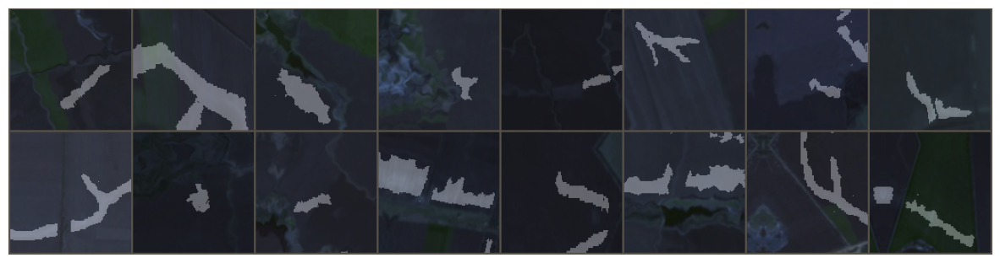

In [24]:
datasets = {name: SoilErosionDataset(name, get_transforms(name)) for name in ['train', 'valid', 'test']}
dataloaders = {name: DataLoader(datasets[name], batch_size=Config.batch_size, 
                                shuffle=True, num_workers=Config.num_workers) 
               for name in ['train', 'valid', 'test']}

for i, (imgs, masks) in enumerate(dataloaders['train']):
    imgs_grid = make_grid(imgs)
    masks_grid = make_grid(masks)
    plt.figure(figsize=(15,10))
    plt.imshow(imgs_grid.numpy().transpose(1,2,0) * Config.std + Config.mean)
    plt.imshow(masks_grid.numpy().transpose(1,2,0), alpha=0.3)
    plt.grid(False)
    plt.axis(False)
    break

models/unet_efficientnet-b5_radam_augment_val_IoU=0.36.ckpt


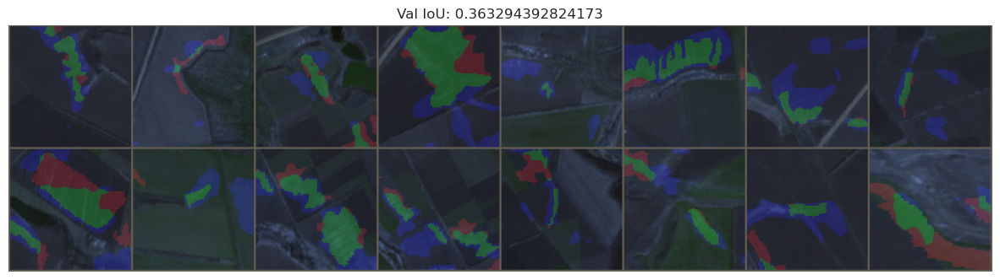

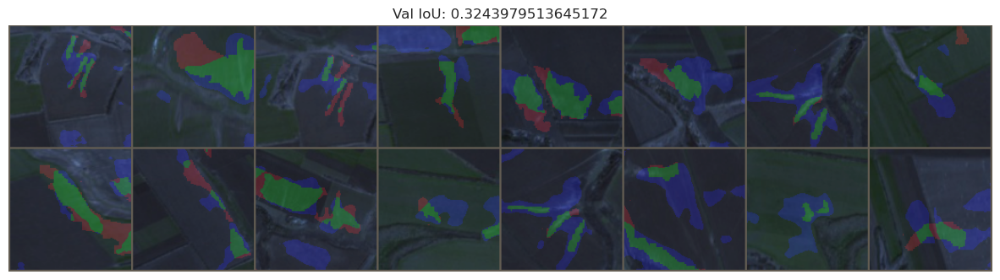

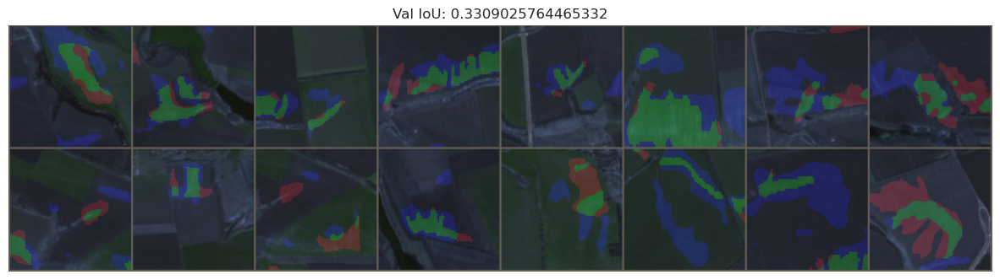

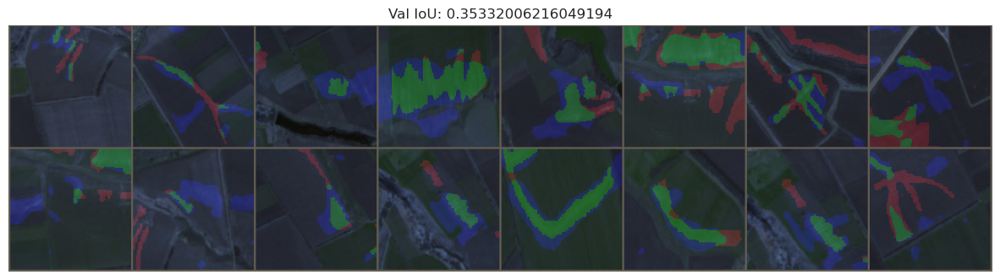

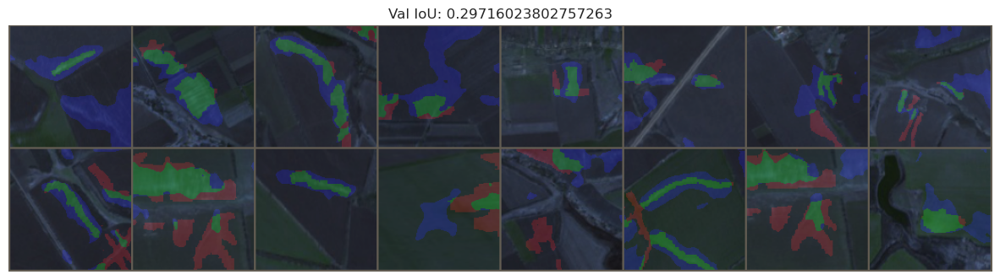

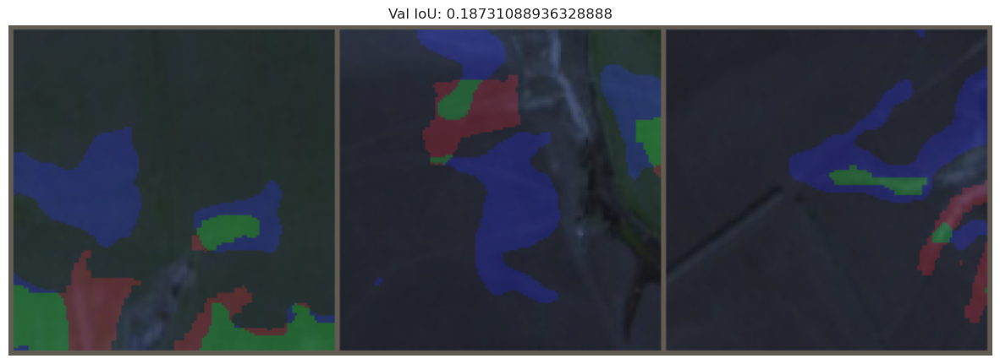

In [3]:
datasets = {name: SoilErosionDataset(name, get_transforms(name)) for name in ['train', 'valid', 'test']}
dataloaders = {name: DataLoader(datasets[name], batch_size=Config.batch_size, 
                                shuffle=True, num_workers=Config.num_workers) 
               for name in ['train', 'valid', 'test']}

best_models = glob.glob('models/unet_efficientnet-b5*')
best_models_index = np.argmax([float(re.search(r"val_IoU=(\d\.\d+)", el).group(1)) for el in best_models])
best_model = SoilErosionSegmentation.load_from_checkpoint(best_models[best_models_index], model=unet, optimizer=optimizer, criterion=criterion)
print(best_models[best_models_index])
IoU = torchmetrics.classification.BinaryJaccardIndex()

for i, (imgs, masks) in enumerate(dataloaders['valid']):
    preds = torch.round(torch.sigmoid(best_model(imgs)))
    green = preds * masks
    blue = torch.clip(preds - masks, min=0)
    red = torch.clip(masks - preds, min=0)
    green_grid = make_grid(green)
    blue_grid = make_grid(blue)
    red_grid = make_grid(red)
    imgs_grid = make_grid(imgs)
    masks_grid = np.zeros_like(imgs_grid)
    masks_grid[0,:,:] = red_grid[0,:,:]
    masks_grid[1,:,:] = green_grid[0,:,:]
    masks_grid[2,:,:] = blue_grid[0,:,:]
   
    plt.figure(figsize=(15,10))
    plt.imshow(imgs_grid.numpy().transpose(1,2,0) * Config.std + Config.mean)
    plt.imshow(masks_grid.transpose(1,2,0), alpha=0.20)
    plt.grid(False)
    plt.axis(False)
    plt.figure
    plt.title(f'Val IoU: {IoU(preds, masks)}')
    plt.show()

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


###   Batch Size   ###


`Trainer.fit` stopped: `max_steps=3` reached.
Batch size 2 succeeded, trying batch size 4
`Trainer.fit` stopped: `max_steps=3` reached.
Batch size 4 succeeded, trying batch size 8
`Trainer.fit` stopped: `max_steps=3` reached.
Batch size 8 succeeded, trying batch size 16
`Trainer.fit` stopped: `max_steps=3` reached.
Batch size 16 succeeded, trying batch size 32
Batch size 32 failed, trying batch size 24
`Trainer.fit` stopped: `max_steps=3` reached.
Batch size 24 succeeded, trying batch size 28
Batch size 28 failed, trying batch size 26
Batch size 26 failed, trying batch size 25
`Trainer.fit` stopped: `max_steps=3` reached.
Finished batch size finder, will continue with full run using batch size 25
Restoring states from the checkpoint path at /home/olehborysevych/Dev/Projects/Soil_erosion/.scale_batch_size_b15021fa-21aa-4d71-883c-2f9b70cdb827.ckpt
Restored all states from the checkpoint file at /home/olehborysevych/Dev/Projects/Soil_erosion/.scale_batch_size_b15021fa-21aa-4d71-883c-2f9b7

###   LR   ###


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_steps=100` reached.
Restoring states from the checkpoint path at /home/olehborysevych/Dev/Projects/Soil_erosion/.lr_find_69ba6d06-176d-414b-b6ff-f12f1f93fdbb.ckpt
Restored all states from the checkpoint file at /home/olehborysevych/Dev/Projects/Soil_erosion/.lr_find_69ba6d06-176d-414b-b6ff-f12f1f93fdbb.ckpt


LR: 0.030199517204020192


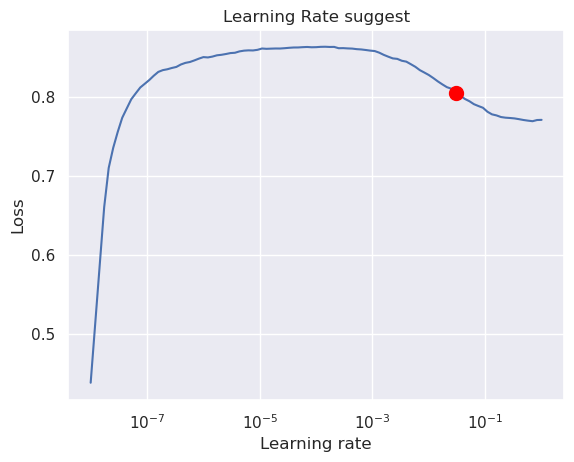

In [12]:
print('###   Batch Size   ###')
t = trainer.tuner.scale_batch_size(model, datamodule=datamodule, mode='binsearch')
print('###   LR   ###')
# for 8 batch size
lr_finder = trainer.tuner.lr_find(model=model, datamodule=datamodule)
fig = lr_finder.plot(suggest=True)
plt.title('Learning Rate suggest')
print(f'LR: {lr_finder.suggestion()}')

In [4]:
datasets = {name: SoilErosionDataset(name, get_transforms(name)) for name in ['train', 'valid', 'test']}
dataloaders = {name: DataLoader(datasets[name], batch_size=Config.batch_size, 
                                shuffle=True, num_workers=Config.num_workers) 
               for name in ['train', 'valid', 'test']}

best_models = glob.glob('models/unet_efficientnet-b5*')
best_models_index = np.argmax([float(re.search(r"val_IoU=(\d\.\d+)", el).group(1)) for el in best_models])
best_model = SoilErosionSegmentation.load_from_checkpoint(best_models[best_models_index], model=unet, optimizer=optimizer, criterion=criterion)
print(best_models[best_models_index])

trainer.test(model=best_model, dataloaders=dataloaders['test'])

models/unet_efficientnet-b5_radam_augment_val_IoU=0.36.ckpt


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      test_IoU_epoch       │    0.2514689862728119     │
│      test_loss_epoch      │    0.6858505606651306     │
└───────────────────────────┴───────────────────────────┘

[{'test_loss_epoch': 0.6858505606651306, 'test_IoU_epoch': 0.2514689862728119}]